In [1]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np

from skimage import color
from skimage.segmentation import slic, felzenszwalb

In [6]:
superpixel_dir = '/scratch/shantanu/scannet_data/superpixels'
img_dir = '/scratch/shantanu/scannet_data/imgs'

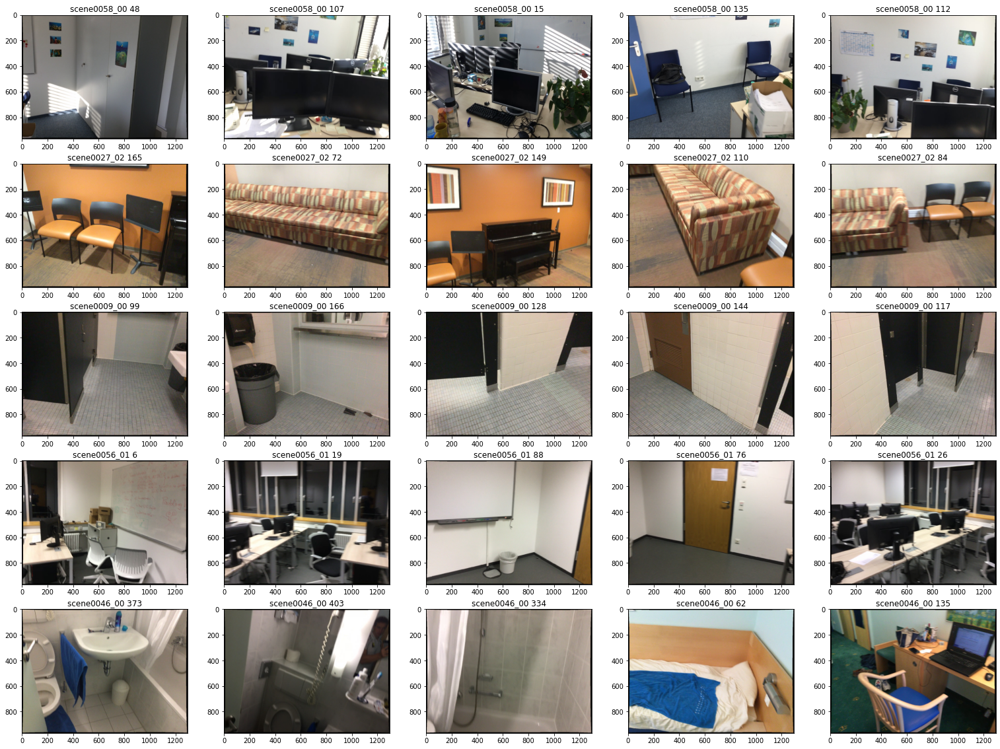

In [7]:
scene_folders = os.listdir(img_dir)
nrows = 5
ncols = 5

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(5.3*ncols, 4*nrows))

tgt_imgs = dict()

for sceneidx, scene_folder in enumerate(scene_folders[:nrows]):
    file_indices = [os.path.splitext(x)[0] for x in os.listdir(os.path.join(img_dir, scene_folder))]
    np.random.shuffle(file_indices)
    tgt_imgs[scene_folder] = file_indices[:ncols]
    for fileidx, filename in enumerate(file_indices[:ncols]):
        rgb_img = cv2.cvtColor(cv2.imread(os.path.join(img_dir, scene_folder, 
                                                       '{}.png'.format(filename))), cv2.COLOR_BGR2RGB)
        ax[sceneidx][fileidx].imshow(rgb_img)
        ax[sceneidx][fileidx].set_title('{} {}'.format(scene_folder, filename))
        
plt.show()

In [8]:
tgt_imgs = {'scene0016_02': ['56', '119', '44', '150', '11'],
 'scene0036_01': ['30', '93', '54', '89', '6'],
 'scene0044_01': ['10', '168', '122', '156', '139'],
 'scene0034_01': ['163', '56', '181', '210', '100'],
 'scene0024_01': ['385', '367', '230', '187', '130']}

## Vary Scale Parameter for felzenszwalb

In [9]:
def plot_felzenszwalb(scene_idx):
    scene_folder = list(tgt_imgs.keys())[scene_idx]

    nrows = len(tgt_imgs[scene_folder])
    ncols = 4

    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols*5.2, nrows*4))
    for fileidx, filename in enumerate(tgt_imgs[scene_folder]):
        image = cv2.cvtColor(cv2.imread(os.path.join(img_dir, scene_folder, 
                                                       '{}.png'.format(filename))), cv2.COLOR_BGR2RGB)
        ax[fileidx][0].imshow(image)
        ax[fileidx][0].set_title('{} {}'.format(scene_folder, filename))

        seg1 = felzenszwalb(image, scale=100, sigma=0.5, min_size=50).astype(np.int16)
        ax[fileidx][1].imshow(color.label2rgb(seg1))
        ax[fileidx][1].set_title('scale=100 n_comps={}'.format(np.unique(seg1).shape[0]))

        seg2 = felzenszwalb(image, scale=125, sigma=0.5, min_size=50).astype(np.int16)
        ax[fileidx][2].imshow(color.label2rgb(seg2))
        ax[fileidx][2].set_title('scale=125 n_comps={}'.format(np.unique(seg2).shape[0]))

        seg3 = felzenszwalb(image, scale=150, sigma=0.5, min_size=50).astype(np.int16)
        ax[fileidx][3].imshow(color.label2rgb(seg3))
        ax[fileidx][3].set_title('scale=150 n_comps={}'.format(np.unique(seg3).shape[0]))

    plt.show()

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


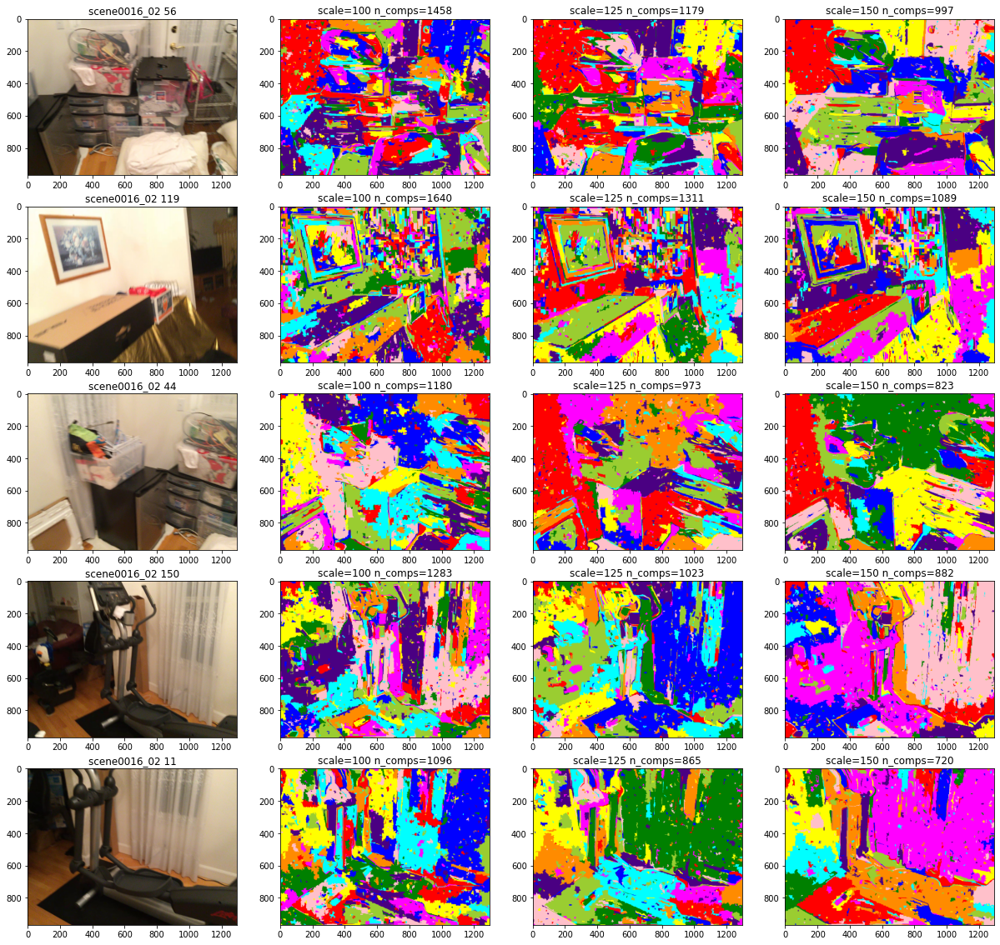

In [10]:
plot_felzenszwalb(0)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


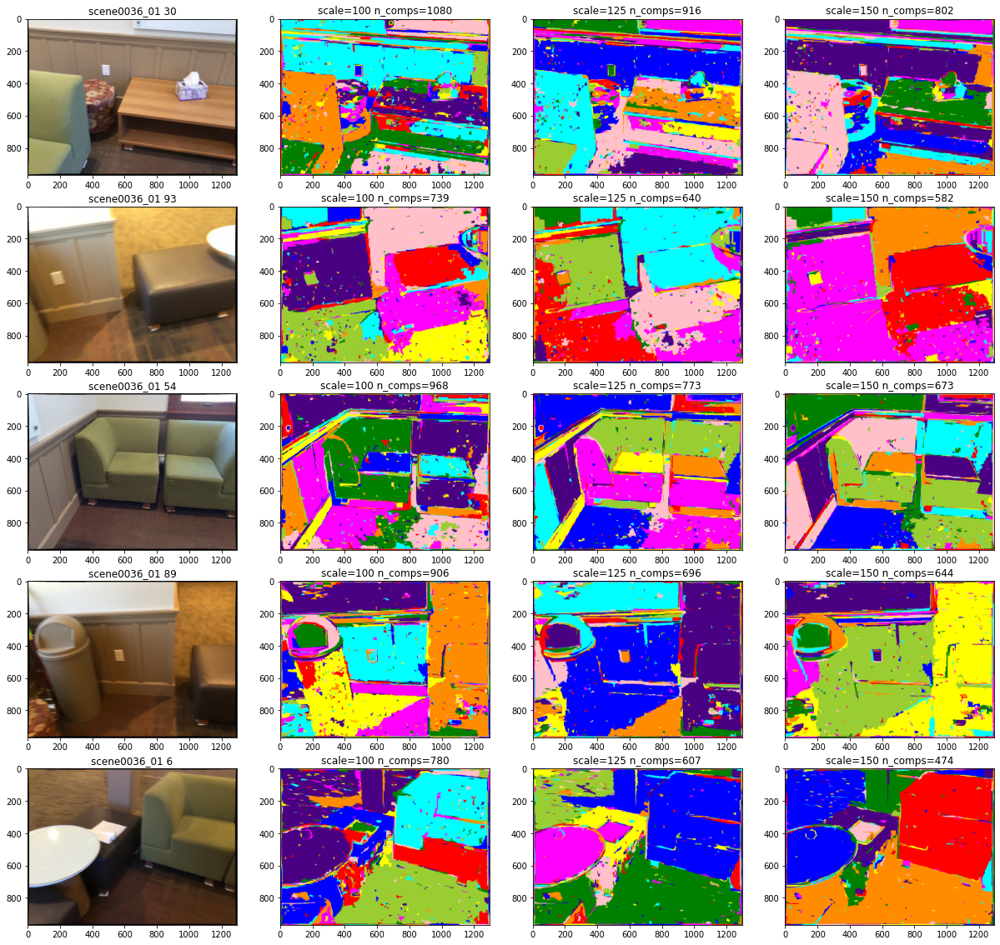

In [11]:
plot_felzenszwalb(1)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


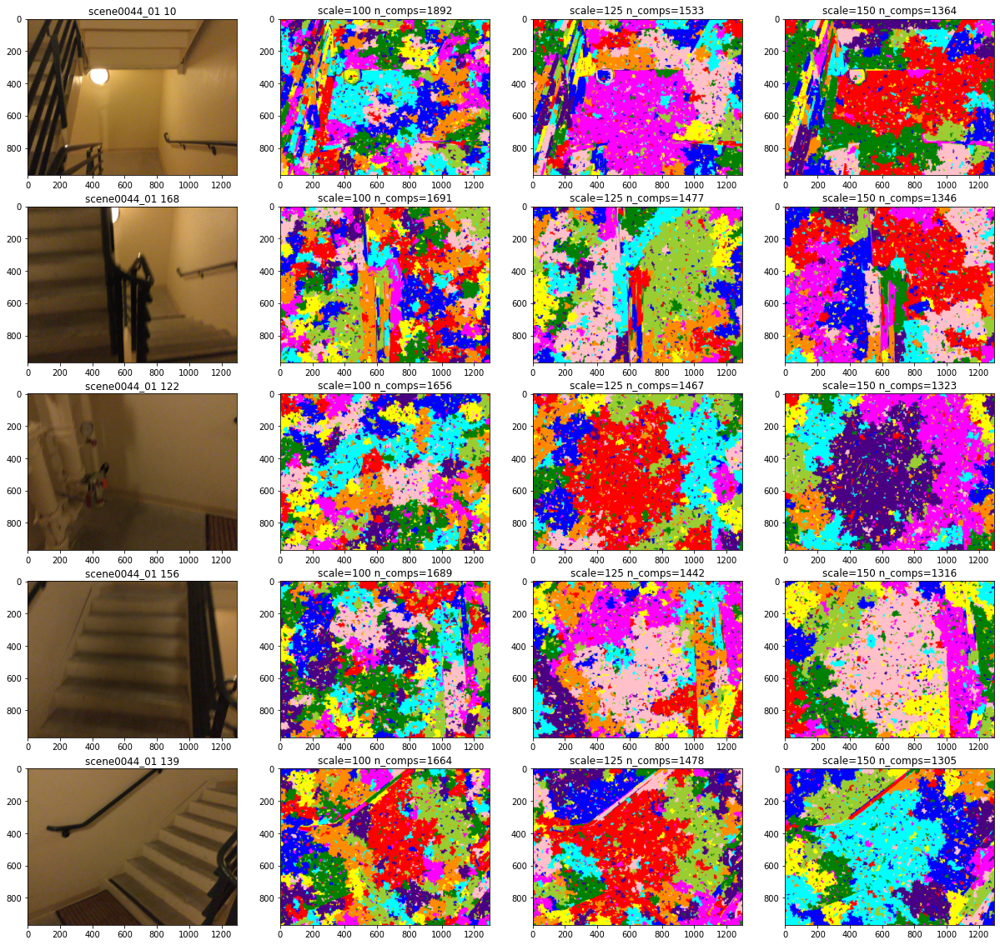

In [12]:
plot_felzenszwalb(2)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


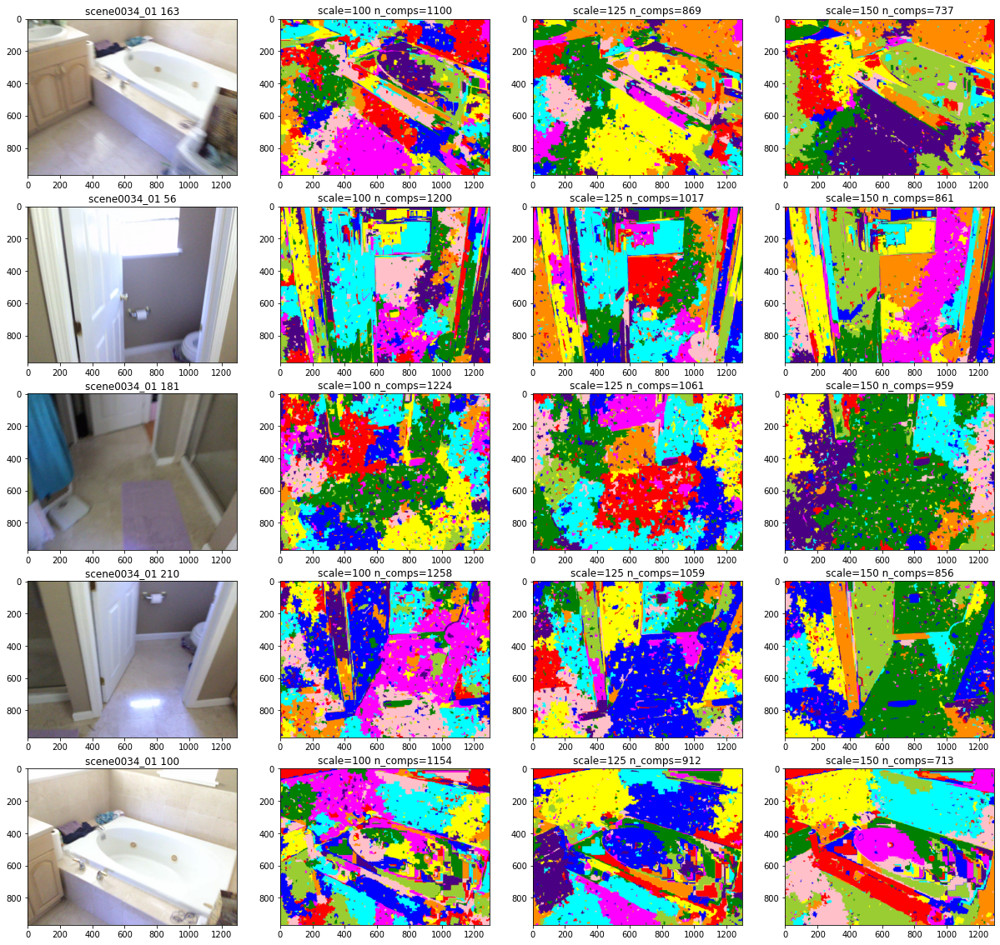

In [13]:
plot_felzenszwalb(3)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


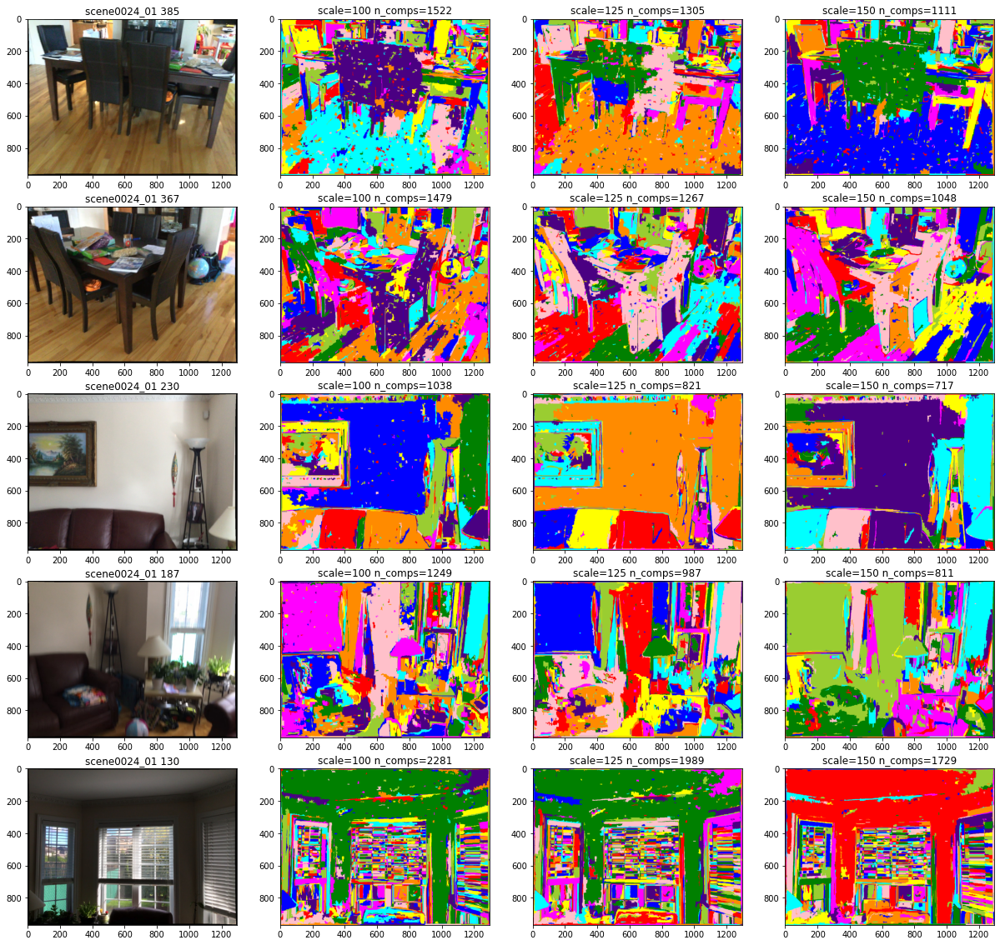

In [14]:
plot_felzenszwalb(4)

From the above results, it appears that scale as 100 gives the best results.

## Vary Sigma Parameter for felzenszwalb

In [39]:
def plot_felzenszwalb(scene_idx):
    scene_folder = list(tgt_imgs.keys())[scene_idx]

    nrows = len(tgt_imgs[scene_folder])
    ncols = 4

    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols*5.2, nrows*4))
    for fileidx, filename in enumerate(tgt_imgs[scene_folder]):
        image = cv2.cvtColor(cv2.imread(os.path.join(img_dir, scene_folder, 
                                                       '{}.png'.format(filename))), cv2.COLOR_BGR2RGB)
        ax[fileidx][0].imshow(image)
        ax[fileidx][0].set_title('{} {}'.format(scene_folder, filename))

        seg1 = felzenszwalb(image, scale=100, sigma=0.5, min_size=50).astype(np.int16)
        ax[fileidx][1].imshow(color.label2rgb(seg1))
        ax[fileidx][1].set_title('sigma=0.5 n_comps={}'.format(np.unique(seg1).shape[0]))

        seg2 = felzenszwalb(image, scale=100, sigma=0.75, min_size=50).astype(np.int16)
        ax[fileidx][2].imshow(color.label2rgb(seg2))
        ax[fileidx][2].set_title('sigma=0.75 n_comps={}'.format(np.unique(seg2).shape[0]))

        seg3 = felzenszwalb(image, scale=100, sigma=1.0, min_size=50).astype(np.int16)
        ax[fileidx][3].imshow(color.label2rgb(seg3))
        ax[fileidx][3].set_title('sigma=1.0 n_comps={}'.format(np.unique(seg3).shape[0]))

    plt.show()

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


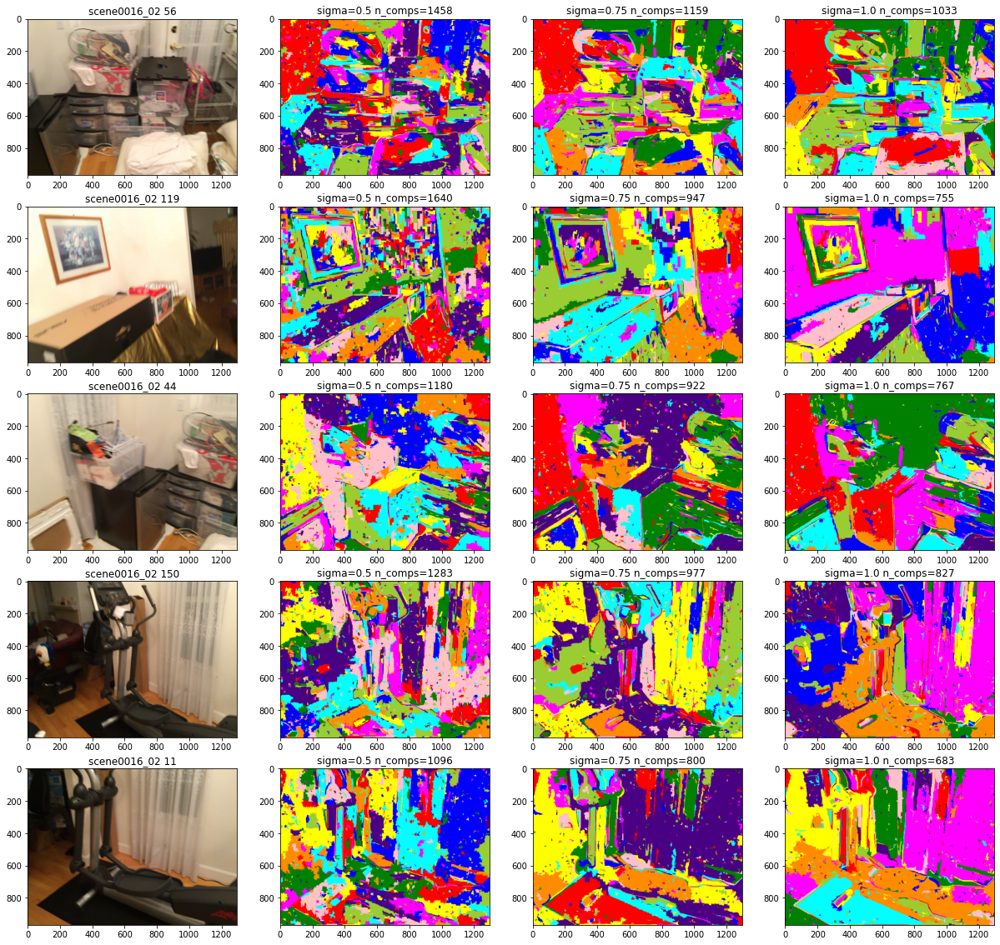

In [40]:
plot_felzenszwalb(0)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


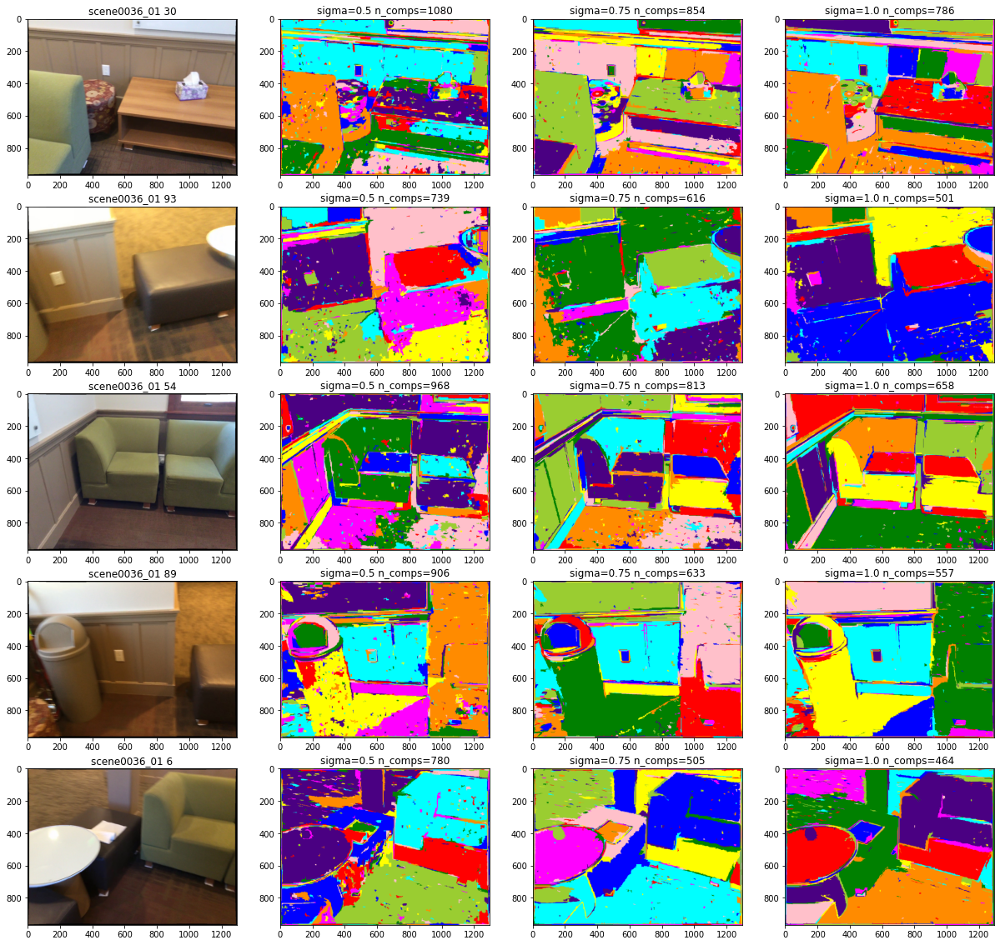

In [41]:
plot_felzenszwalb(1)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


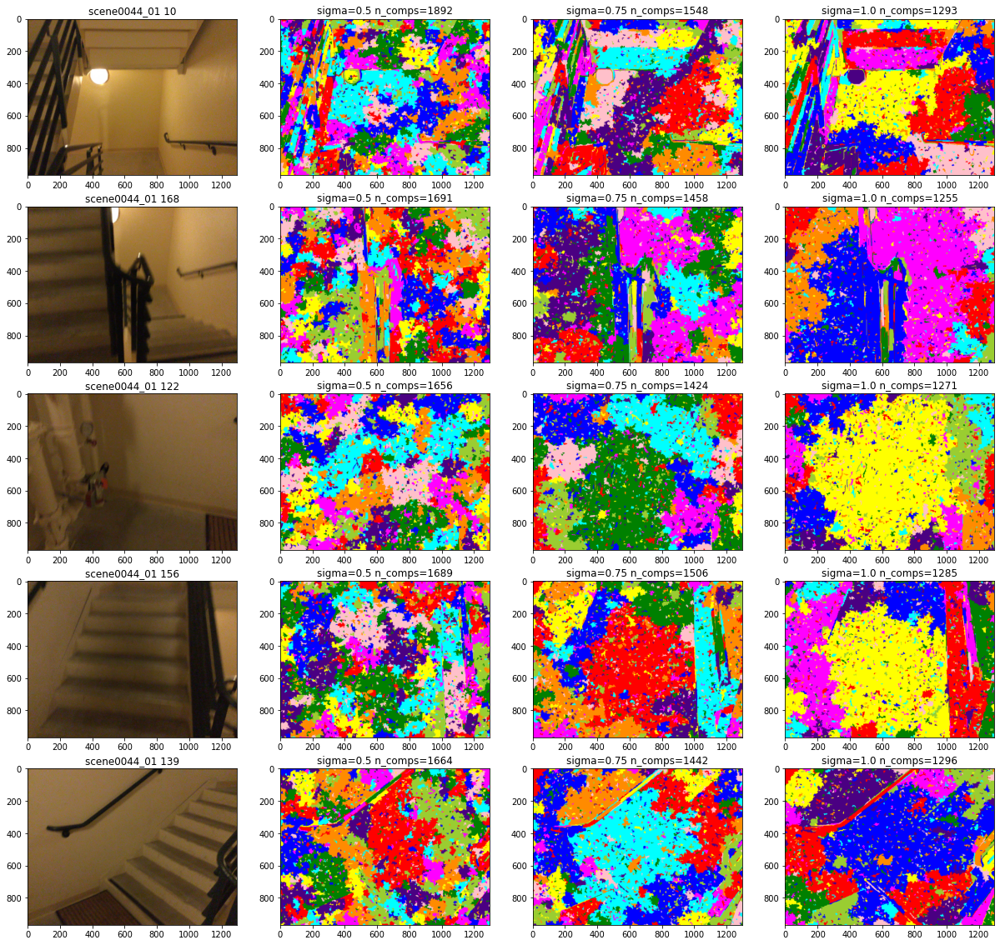

In [42]:
plot_felzenszwalb(2)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


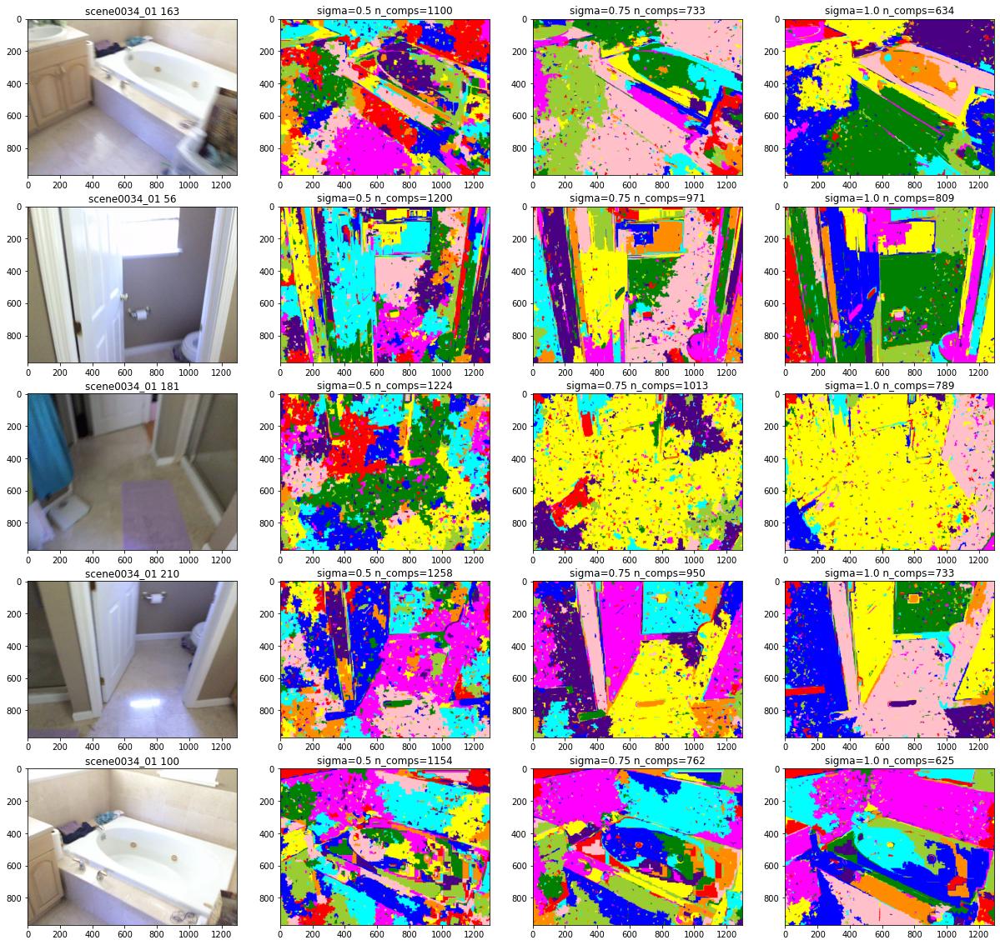

In [43]:
plot_felzenszwalb(3)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


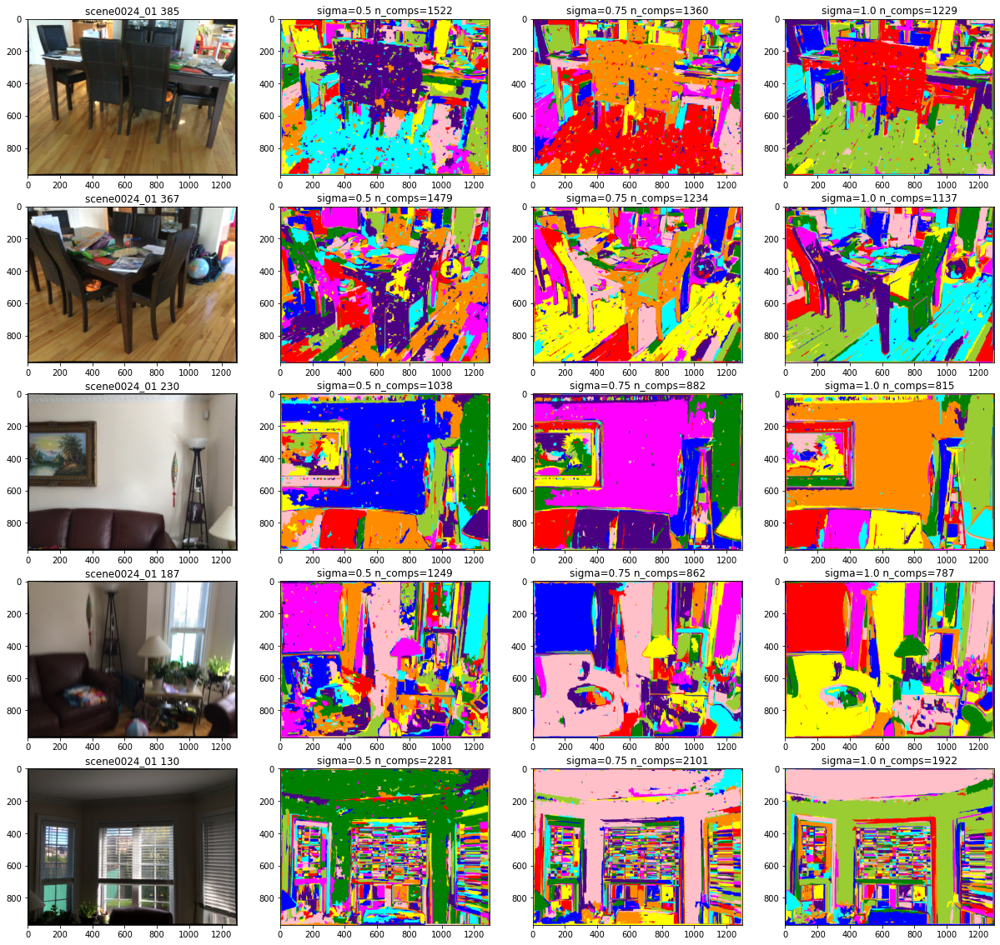

In [44]:
plot_felzenszwalb(4)

From the above results, it appears that sigma=0.5 gives the best result.

## Vary min_size Parameter for felzenszwalb

In [46]:
def plot_felzenszwalb(scene_idx):
    scene_folder = list(tgt_imgs.keys())[scene_idx]

    nrows = len(tgt_imgs[scene_folder])
    ncols = 4

    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols*5.2, nrows*4))
    for fileidx, filename in enumerate(tgt_imgs[scene_folder]):
        image = cv2.cvtColor(cv2.imread(os.path.join(img_dir, scene_folder, 
                                                       '{}.png'.format(filename))), cv2.COLOR_BGR2RGB)
        ax[fileidx][0].imshow(image)
        ax[fileidx][0].set_title('{} {}'.format(scene_folder, filename))

        seg1 = felzenszwalb(image, scale=100, sigma=0.5, min_size=10).astype(np.int16)
        ax[fileidx][1].imshow(color.label2rgb(seg1))
        ax[fileidx][1].set_title('min_size=10 n_comps={}'.format(np.unique(seg1).shape[0]))

        seg2 = felzenszwalb(image, scale=100, sigma=0.5, min_size=50).astype(np.int16)
        ax[fileidx][2].imshow(color.label2rgb(seg2))
        ax[fileidx][2].set_title('min_size=50 n_comps={}'.format(np.unique(seg2).shape[0]))

        seg3 = felzenszwalb(image, scale=100, sigma=0.5, min_size=100).astype(np.int16)
        ax[fileidx][3].imshow(color.label2rgb(seg3))
        ax[fileidx][3].set_title('min_size=100 n_comps={}'.format(np.unique(seg3).shape[0]))

    plt.show()

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


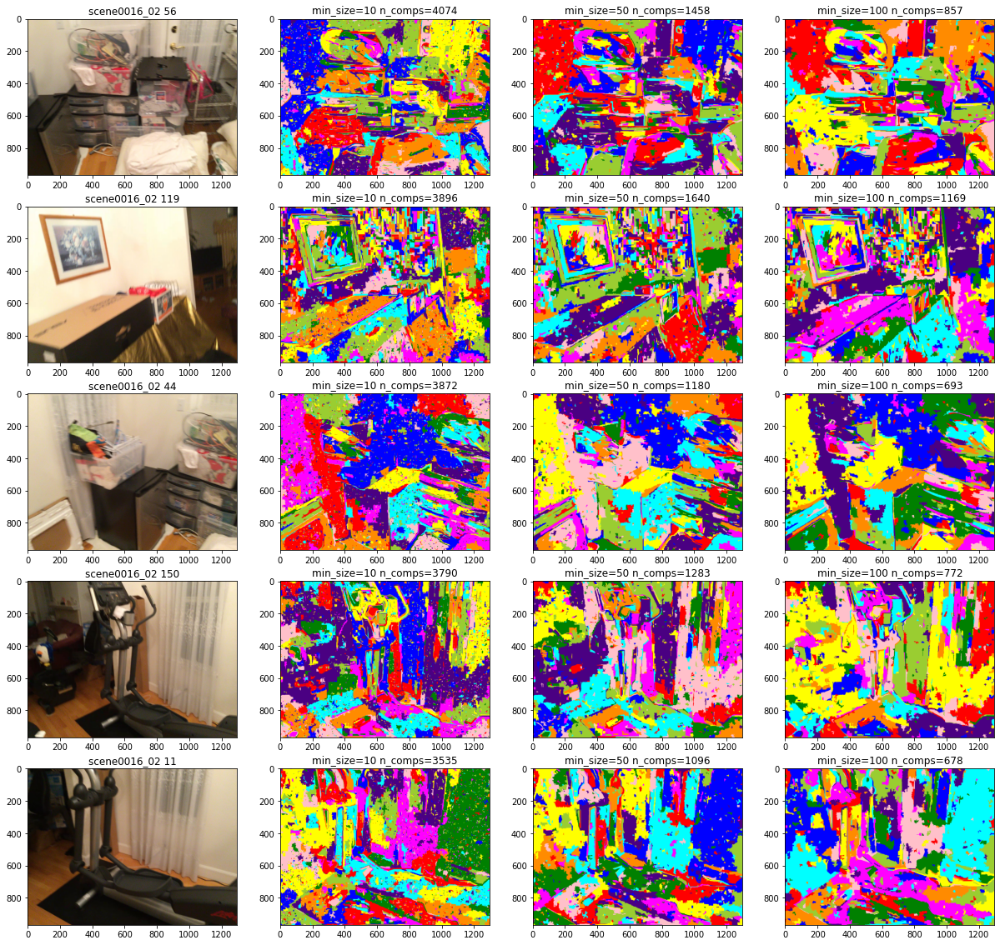

In [47]:
plot_felzenszwalb(0)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


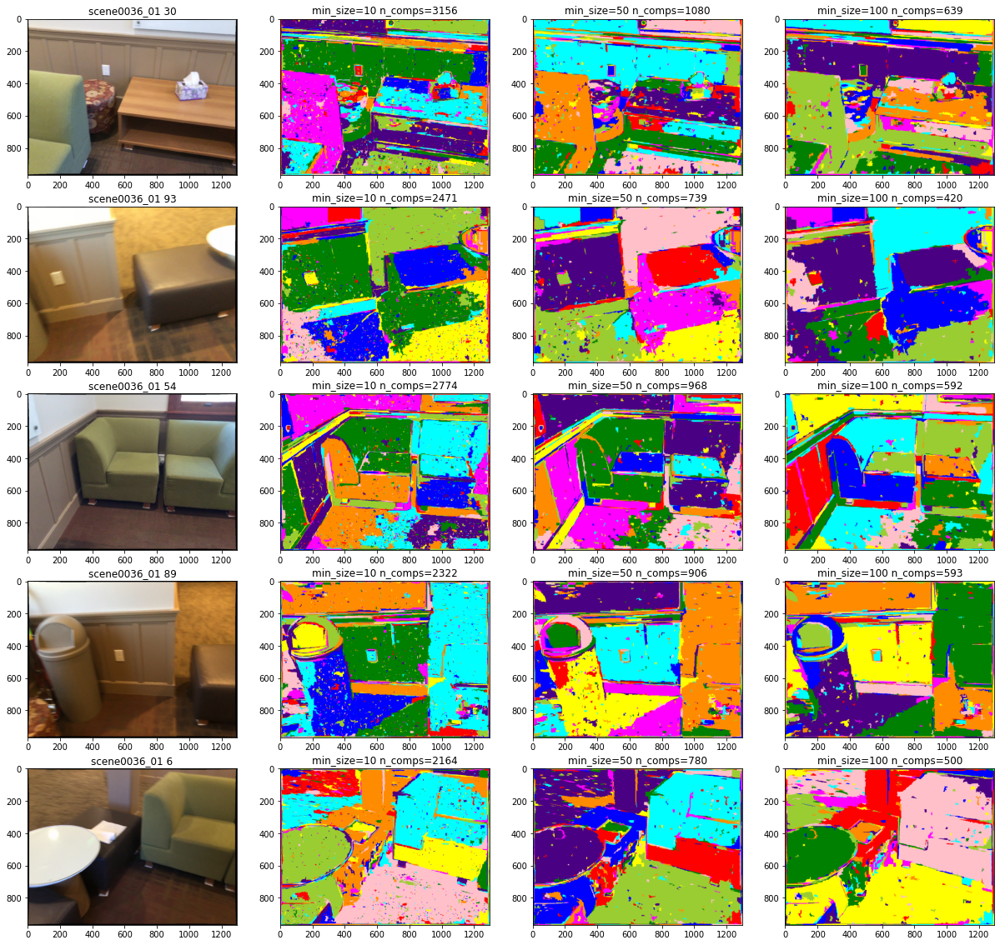

In [48]:
plot_felzenszwalb(1)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


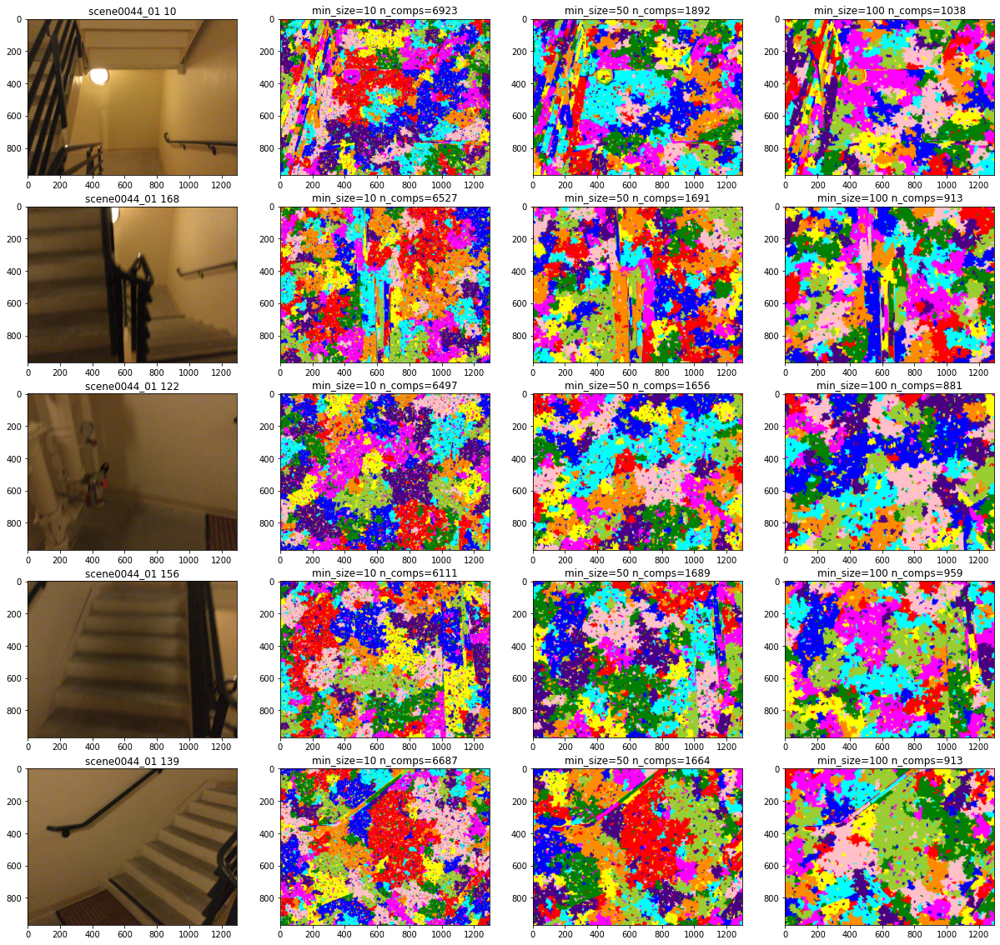

In [49]:
plot_felzenszwalb(2)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


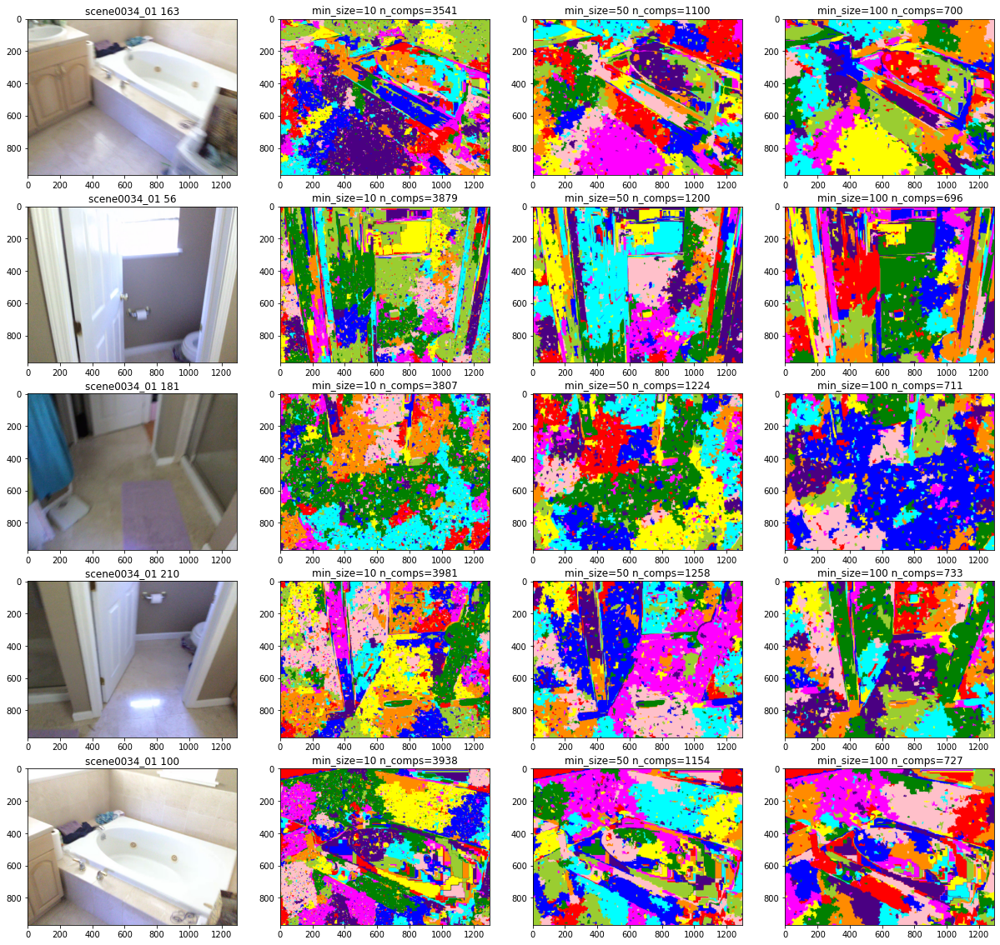

In [50]:
plot_felzenszwalb(3)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:23: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.


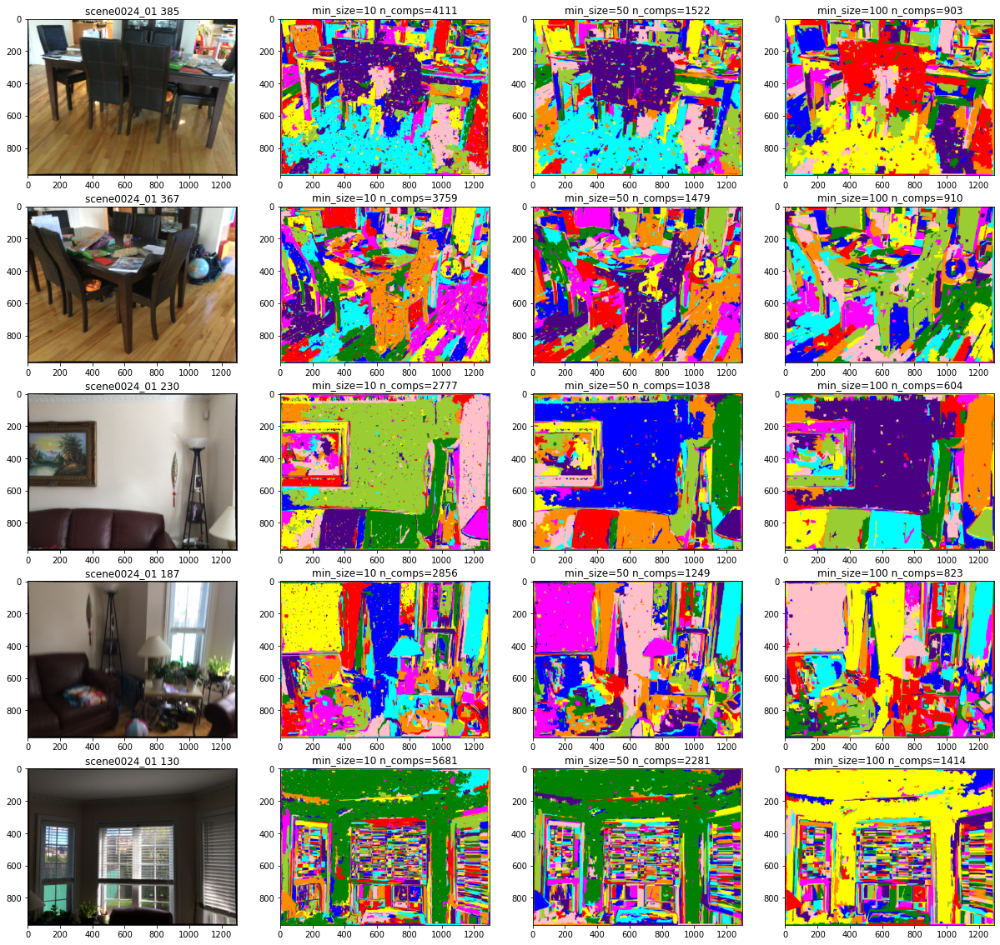

In [51]:
plot_felzenszwalb(4)

From the above results, it seems that min_size as 100 gives the best output.

#### Therefore ideal parameters for felzenszwalb are scale=100, sigma=0.5, min_size=100.

# SLIC - compactness and n_segments

In [88]:
def plot_slic(scene_idx, n_segments):
    scene_folder = list(tgt_imgs.keys())[scene_idx]

    nrows = len(tgt_imgs[scene_folder])
    ncols = 4

    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols*5.2, nrows*4))
    for fileidx, filename in enumerate(tgt_imgs[scene_folder]):
        image = cv2.cvtColor(cv2.imread(os.path.join(img_dir, scene_folder, 
                                                       '{}.png'.format(filename))), cv2.COLOR_BGR2RGB)
        ax[fileidx][0].imshow(image)
        ax[fileidx][0].set_title('{} {}'.format(scene_folder, filename))

        seg1 = slic(image, compactness=0.5, n_segments=n_segments)
        ax[fileidx][1].imshow(color.label2rgb(seg1))
        ax[fileidx][1].set_title('compactness=0.5 n_comps={}'.format(np.unique(seg1).shape[0]))

        seg2 = slic(image, compactness=1, n_segments=n_segments)
        ax[fileidx][2].imshow(color.label2rgb(seg2))
        ax[fileidx][2].set_title('compactness=1 n_comps={}'.format(np.unique(seg2).shape[0]))

        seg3 = slic(image, compactness=2, n_segments=n_segments)
        ax[fileidx][3].imshow(color.label2rgb(seg3))
        ax[fileidx][3].set_title('compactness=2 n_comps={}'.format(np.unique(seg3).shape[0]))

    plt.show()

### Scene 0

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:18: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for

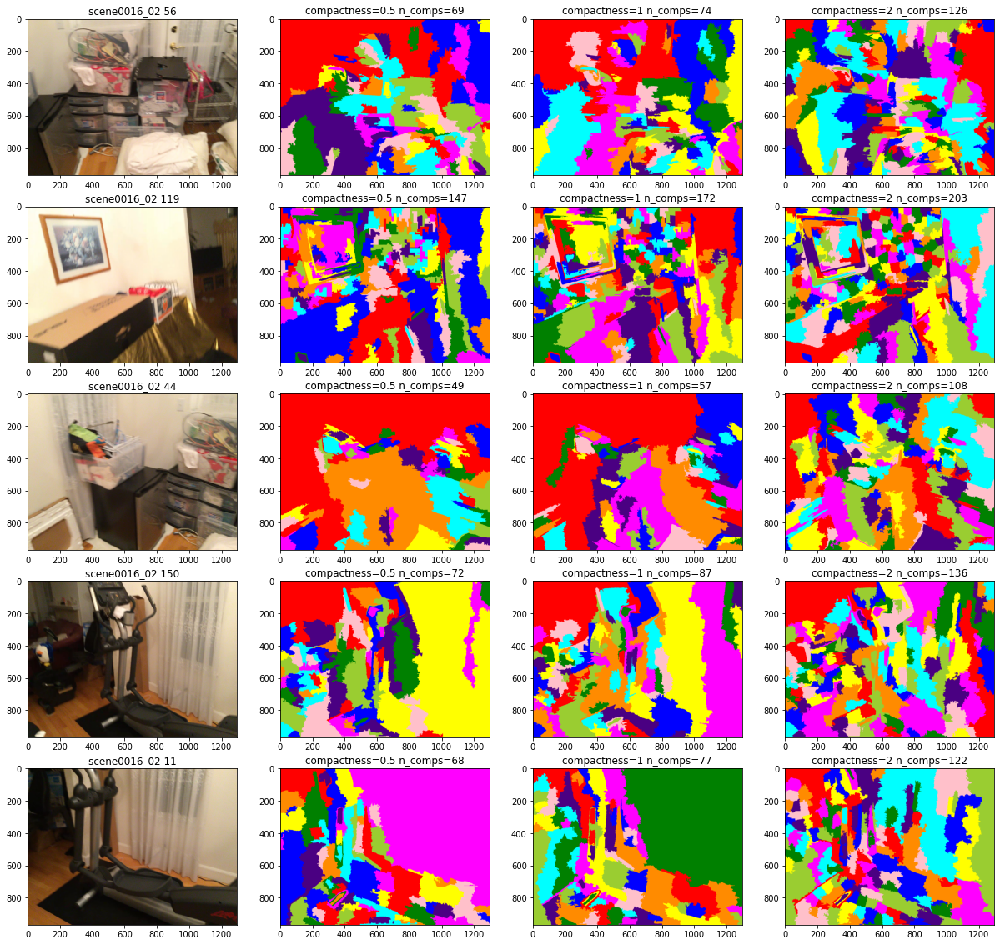

In [89]:
plot_slic(0, 500)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:18: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for

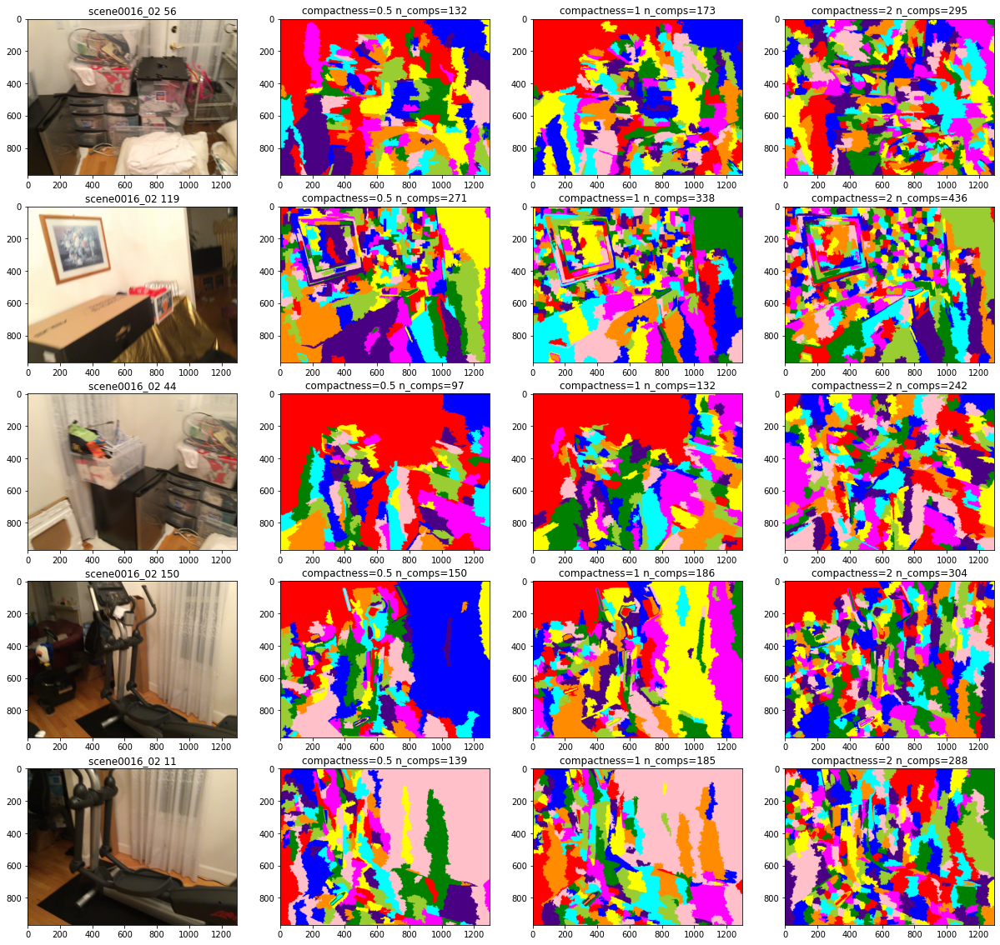

In [90]:
plot_slic(0, 1000)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:18: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for

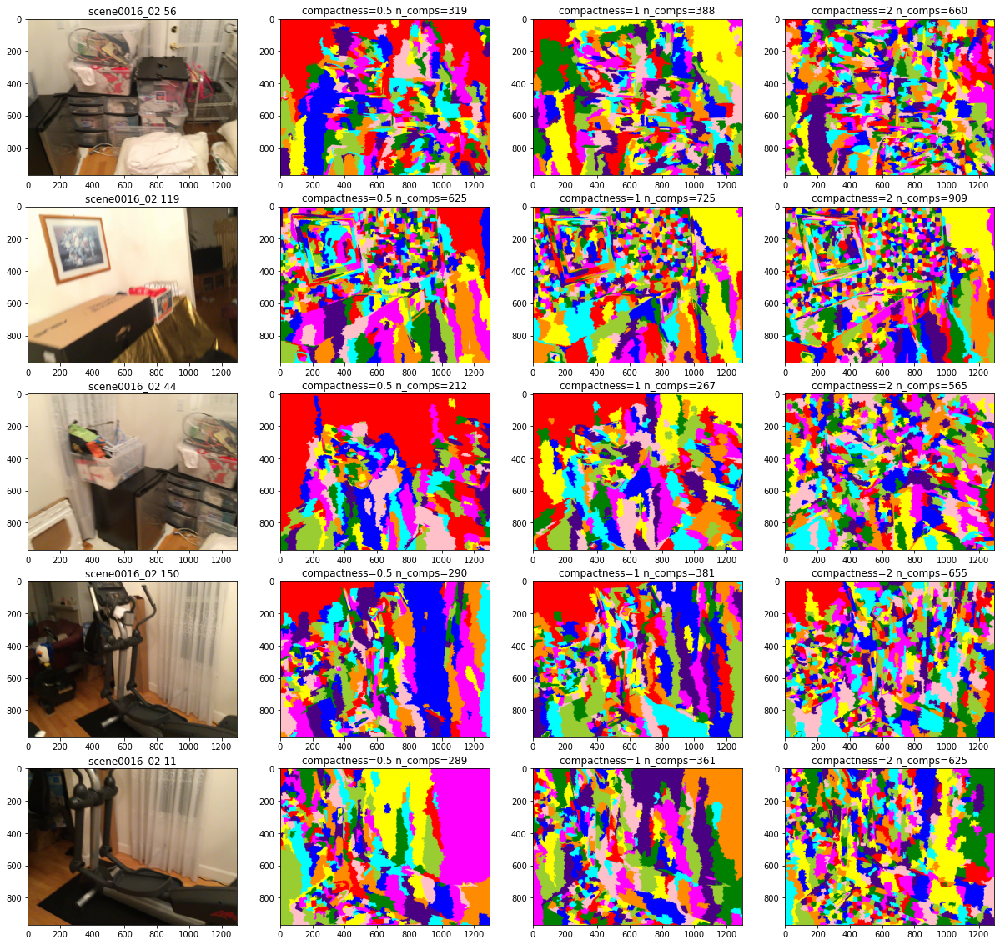

In [91]:
plot_slic(0, 2000)

### Scene 2

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:18: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for

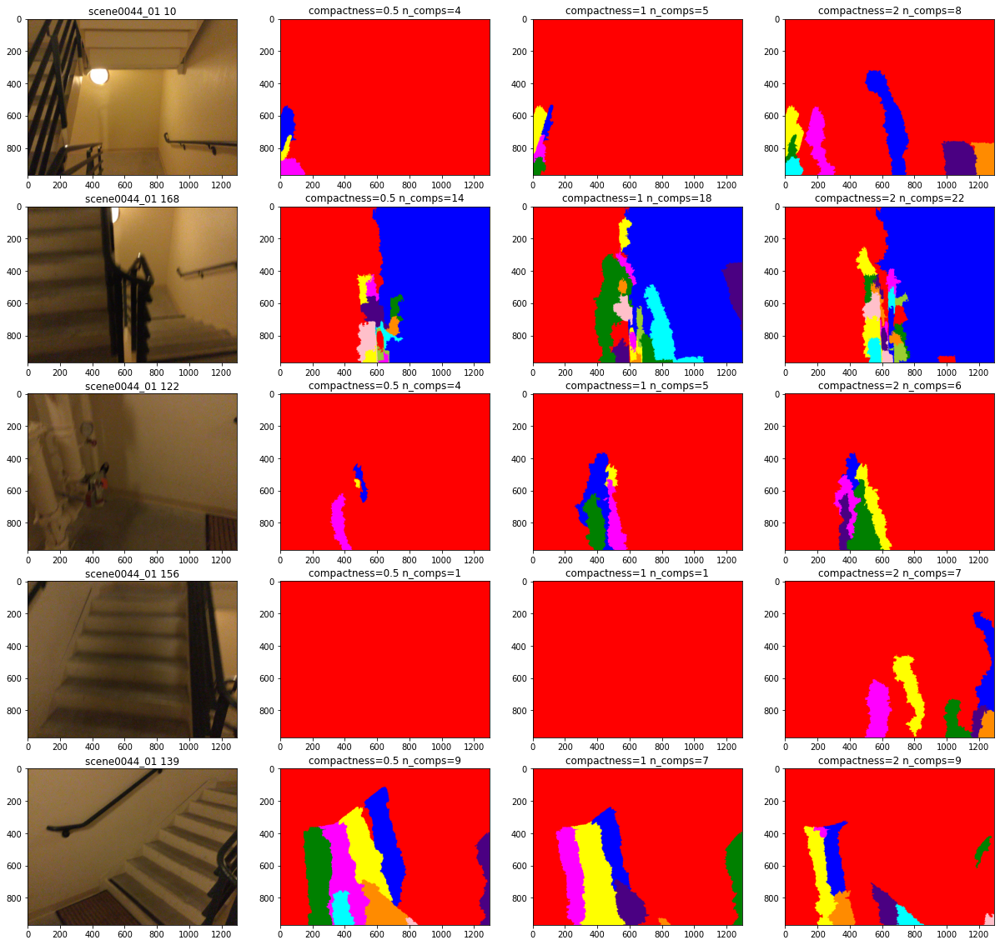

In [95]:
plot_slic(2, 500)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:18: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for

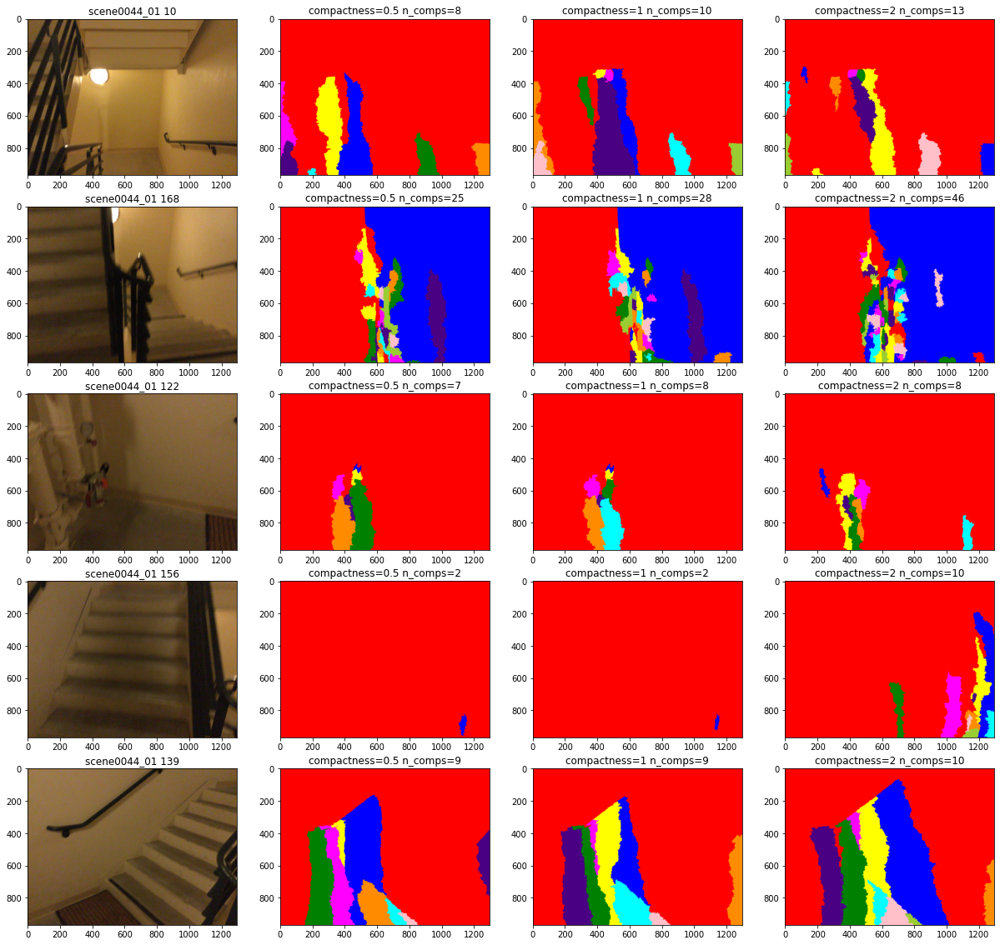

In [96]:
plot_slic(2, 1000)

/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:14: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  from ipykernel import kernelapp as app
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:18: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
/home/shantanusingh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:19: FutureWarning: The new recommended value for

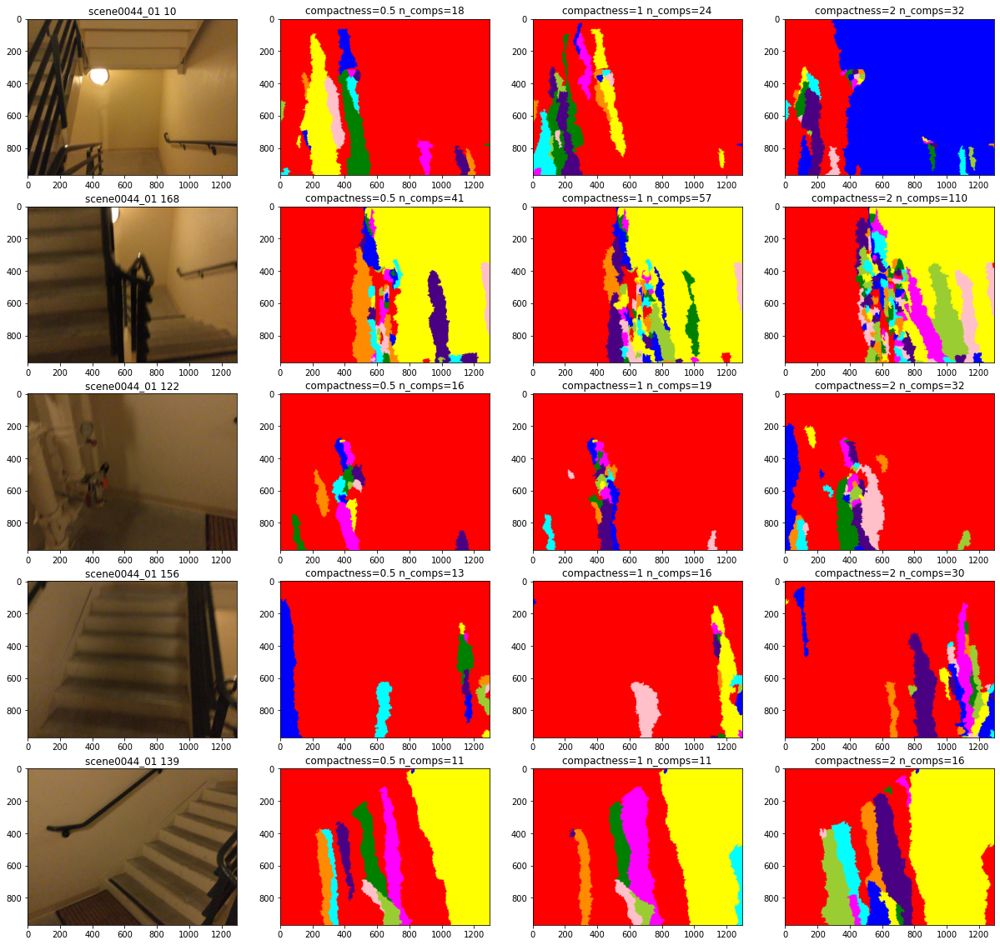

In [94]:
plot_slic(2, 2000)

From the above two plots, it is clear that slic does not give good results and should not be used.